<h1>Spectral Analysis on Forward Pass</h1>

In this notebook, we are looking at whether or not the forward pass of flow models is autoregressive. For all models we are assuming:

\begin{align}
x_0 &\sim \mathcal{N}(0, 1) \\

x_1 &\sim \text{CIFAR-10}
\end{align}

We then want to move from $x_1$ to $x_0$ following table 1 in https://arxiv.org/abs/2302.00482.

## Imports and Constants

In [1]:
from matplotlib import rc
rc('animation', html='jshtml')
import matplotlib.pyplot as plt
from matplotlib import animation

import torch
import torch.nn as nn
from torchvision import datasets, transforms
from pathlib import Path
import os

In [2]:
FM_NAME = "si"

ROOT = Path.cwd().parent.parent.parent
IMAGE_PATH = ROOT / "assets" / FM_NAME / "images" / "forward"
os.makedirs(IMAGE_PATH, exist_ok=True)

## Load the dataset (CIFAR-10)

In [3]:
dataset = datasets.CIFAR10(
    root="../../../data",
    train=True,
    download=False,
    transform=transforms.Compose(
        [
            transforms.RandomHorizontalFlip(),
            transforms.ToTensor(),
            transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
        ]
    ),
)

dataloader = torch.utils.data.DataLoader(
    dataset,
    batch_size=16,
    shuffle=True,
    num_workers=4,
    drop_last=True,
)

In [4]:
from torchcfm.conditional_flow_matching import (
    TargetConditionalFlowMatcher, 
    SchrodingerBridgeConditionalFlowMatcher, 
    VariancePreservingConditionalFlowMatcher, 
    ExactOptimalTransportConditionalFlowMatcher,
    ConditionalFlowMatcher
)

def get_forward_pass(model, x0, x1, t):
    t, xt, ut = model.sample_location_and_conditional_flow(x0, x1, t)
    return xt

if FM_NAME == "fm":
    FM = TargetConditionalFlowMatcher()
elif FM_NAME == "sbcfm":
    FM = SchrodingerBridgeConditionalFlowMatcher()
elif FM_NAME == "si":
    FM = VariancePreservingConditionalFlowMatcher()
elif FM_NAME == "otcfm":
    FM = ExactOptimalTransportConditionalFlowMatcher()
elif FM_NAME == "icfm":
    FM = ConditionalFlowMatcher()

x1 = next(iter(dataloader))[0]
x0 = torch.normal(0, 1, x1.size())

batch_size = x0.size(0)

TIME_STEPS = 100
t = torch.linspace(0, 1, TIME_STEPS)
t = t.repeat(batch_size, 1)

In [5]:
def plot_images(images, title, _format=False):
    if _format:
        images = images.permute(0, 2, 3, 1).detach().numpy() / 2 + 0.5
    fig, ax = plt.subplots(4, 4, figsize=(8, 8))
    for i in range(4):
        for j in range(4):
            ax[i, j].imshow(images[i * 4 + j])
            ax[i, j].axis("off")
    plt.suptitle(title)
    plt.tight_layout()
    plt.show()

In [6]:
import matplotlib.pyplot as plt
import numpy as np

all_images = torch.zeros_like(x1)
all_images = all_images.permute(0, 2, 3, 1).cpu().unsqueeze(0)
all_images = all_images.repeat(t.size(1), 1, 1, 1, 1)

mu_ts = torch.zeros_like(all_images)
sigma_ts = torch.zeros_like(t).permute(1, 0)

for i in range(t.size(1)):
    t_ = t[:, i]
    xt = get_forward_pass(FM, x0, x1, t_)
    xt = xt.detach()
    xt = xt / 2 + 0.5
    xt = xt.clip(0, 1)
    xt = xt.permute(0, 2, 3, 1)
    all_images[i] = xt
    
    mu_t = FM.compute_mu_t(x0, x1, t_).permute(0, 2, 3, 1)
    sigma_t = FM.compute_sigma_t(t_)
    mu_ts[i] = mu_t
    sigma_ts[i] = sigma_t

all_images = all_images.numpy()

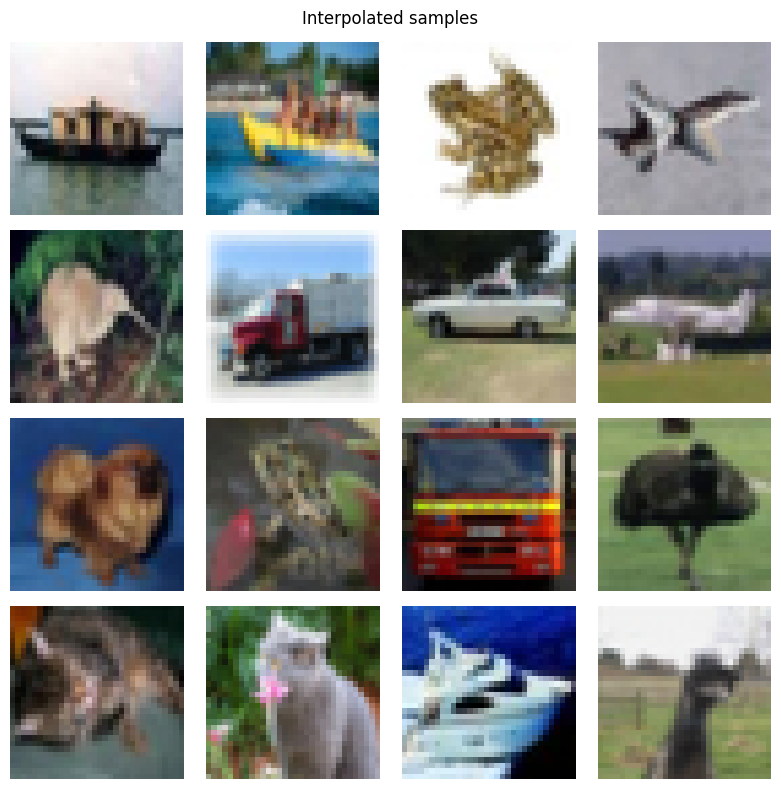

In [7]:
x_1t = torch.tensor(all_images[-1])
plot_images(x_1t, "Interpolated samples", _format=False)

In [8]:
num_images = all_images.shape[1]

rows = np.ceil(np.sqrt(num_images)).astype(int)
cols = np.ceil(num_images / rows).astype(int)

fig, axs = plt.subplots(rows, cols, figsize=(16, 16))

artists = []


for i in range(all_images.shape[0]):
    images = all_images[-i-1]
    container = []
    for j in range(images.shape[0]):
        ax = axs[j // cols, j % cols]
        ax.axis("off")
        container += [ax.imshow(images[j])]
    artists.append(container)

plt.close()

ani = animation.ArtistAnimation(fig, artists, interval=100, blit=True, repeat_delay=1000)
ani

In [9]:
ani.save(IMAGE_PATH / "sample.gif", writer="imagemagick", fps=10)

MovieWriter imagemagick unavailable; using Pillow instead.


In [10]:
import pysteps.utils.spectral as spectral

def calc_mean_log_rapsd(x, num_examples):
  spectra = []
  for k in range(num_examples):
    rapsd, frequencies = spectral.rapsd(x[k, ...], fft_method=np.fft, return_freq=True)
    spectra.append(rapsd)

  mean_log_rapsd = np.mean(np.array([np.log(s + 1e-30) for s in spectra]), axis=0)
  return mean_log_rapsd, frequencies

Pysteps configuration file found at: /Users/oskarjor/miniconda3/envs/torchcfm/lib/python3.10/site-packages/pysteps/pystepsrc



In [11]:
total_time_steps = all_images.shape[0]
num_examples = all_images.shape[1]

images = all_images[-1]
mean_log_rapsd, frequencies = calc_mean_log_rapsd(images[..., 1], num_examples)

In [12]:
i = 0
mu_t = mu_ts[i]
sigma_t = sigma_ts[i]

sigma_t = sigma_t.repeat(32, 32, 3, 1).permute(3, 0, 1, 2)

In [13]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5), width_ratios=[2, 1])

ax1.plot(frequencies[1:], np.exp(mean_log_rapsd)[1:], c='red', marker='o', markersize=3, label='images')
ax1.set_xscale('log')
ax1.set_yscale('log')
ax1.set_ylim([2e-4, 1e1])
ax1.set_xlabel('frequency')
ax1.set_ylabel('power')
ax2.axis('off')

num_steps = total_time_steps
cycles_per_sec = 0.2
selected_image_idx = 0

artists = []
for i in range(0, num_steps):
  noisy_images = all_images[-i-1]
  mu_t = mu_ts[-i-1]
  sigma_t = sigma_ts[-i-1].repeat(32, 32, 3, 1).permute(3, 0, 1, 2)
  noise = noisy_images - images
  mean_log_rapsd_sum, _ = calc_mean_log_rapsd(noisy_images[..., 1], num_examples=num_examples)
  mean_log_rapsd_noise, _ = calc_mean_log_rapsd(noise[..., 1], num_examples=num_examples)
  container = ax1.plot(frequencies[1:], np.exp(mean_log_rapsd_sum)[1:], c='green', marker='o', markersize=3, label='noisy images')
  container += ax1.plot(frequencies[1:], np.exp(mean_log_rapsd_noise)[1:], c='blue', marker='o', markersize=3, label='noise')
  
  container += [ax2.imshow(np.clip(noisy_images[selected_image_idx], 0, 1))]

  artists.append(container)

plt.close()  # Avoid showing static plot, we only want to see the animation.

anim = animation.ArtistAnimation(fig=fig, artists=artists, interval=1000 / (num_steps * cycles_per_sec))
anim

In [14]:
anim.save(IMAGE_PATH / f'image_to_noise_{batch_size}_spectral.gif', writer='imagemagick', fps=30)

MovieWriter imagemagick unavailable; using Pillow instead.


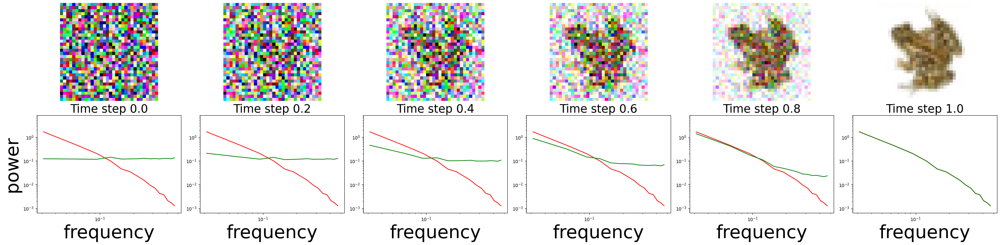

In [15]:
width = 6
fig, ax = plt.subplots(2, width, figsize=(5 * width, 7))
fig.tight_layout()

num_steps = width
cycles_per_sec = 0.2
selected_image_idx = 2

noise_scale_min, noise_scale_max = 0.02, 50.0

lower_lim, upper_lim = np.exp(mean_log_rapsd[1:]).min(), np.exp(mean_log_rapsd[1:]).max()
lower_lim, upper_lim = lower_lim * 0.5, upper_lim * 5

idxs = np.linspace(0, total_time_steps-1, num_steps).astype(int)

for i in range(num_steps):
  idx = idxs[i]
  noisy_images = all_images[idx]
  noise = images - noisy_images
  # mean_log_rapsd_noise, _ = calc_mean_log_rapsd(noise[..., 1], num_examples=num_examples)
  mean_log_rapsd_sum, _ = calc_mean_log_rapsd(noisy_images[..., 1], num_examples=num_examples)
  # plot image in subplot i
  ax[0, i].imshow(np.clip(noisy_images[selected_image_idx], 0, 1))
  ax[0, i].axis('off')
  # plot rapsd in subplot i
  ax[1, i].set_title(f"Time step {(idx / (total_time_steps - 1)):.1f}", fontsize=25)
  ax[1, i].set_xscale('log')
  ax[1, i].set_yscale('log')
  ax[1, i].set_xlabel('frequency', fontsize=40)
  ax[1, i].set_ylim(lower_lim, upper_lim)
  if i == 0:
    ax[1, i].set_ylabel('power', fontsize=40)
  ax[1, i].plot(frequencies[1:], np.exp(mean_log_rapsd)[1:], c='red', label='images')
  # ax[1, i].plot(frequencies[1:], np.exp(mean_log_rapsd_noise)[1:], c='blue', label='noise')
  ax[1, i].plot(frequencies[1:], np.exp(mean_log_rapsd_sum)[1:], c='green', label='noisy images')


plt.savefig(IMAGE_PATH / "power_law.png", bbox_inches='tight')

# Additional experiments

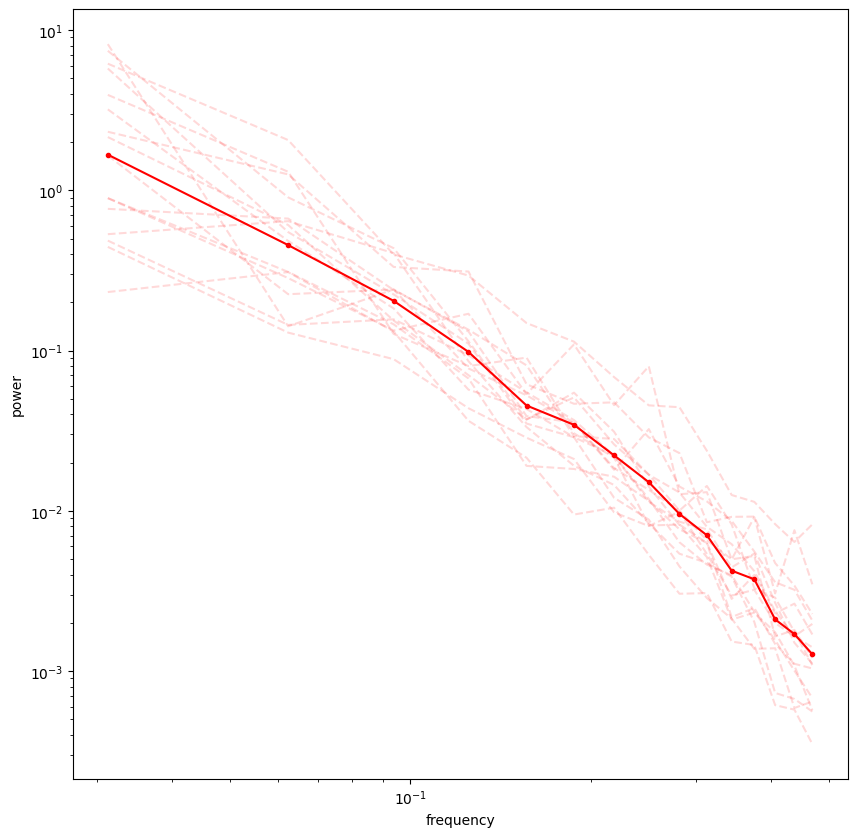

In [16]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))

ax.plot(frequencies[1:], np.exp(mean_log_rapsd)[1:], c='red', marker='o', markersize=3, label='images')
ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('frequency')
ax.set_ylabel('power')

for i in range(num_images):
    image = all_images[-1][i:i+1]
    single_image_mean_log_rapsd, frequencies = calc_mean_log_rapsd(image[..., 1], 1)
    ax.plot(frequencies[1:], np.exp(single_image_mean_log_rapsd)[1:], "--", c='red', markersize=3, label=f'image_{i}', alpha=0.15)

plt.show()